<a href="https://colab.research.google.com/github/mohammadrezashariat/DS_SP/blob/master/Detect_Segment_solar_panels_satellite_photos.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Solar Panel Detection and Segmentation**

---

##**Introduction**
In this project, we aim to develop a deep learning model for the detection and segmentation of solar panels in satellite images. The goal is to accurately identify and outline the boundaries of solar panels within the images. This task is crucial for various applications, including solar energy planning, monitoring, and analysis.

---

##**Dataset**
To train our model, we utilize the following datasets:



**1.   Solar Panel Detection Dataset: [Roboflow - Francesco Talarico](https://universe.roboflow.com/francesco-talarico/pannelli-8wkam)**

This dataset contains satellite images annotated with bounding boxes around the solar panels. It provides a labeled training set for solar panel detection.

**2.   Solar Panel Segmentation Dataset: [Roboflow - SolarPanel](https://universe.roboflow.com/solarpanel-3ku0x/solar_panel-cvecl)**

This dataset includes satellite images with pixel-level segmentation masks for solar panels. It provides a labeled training set for solar panel segmentation.



---

##**Data Preprocessing**


### **Detection Dataset**

####**1.Auto-Orient:**
The images are automatically oriented to the correct position if needed.
####**2.Resize:** 
The images are resized to a fixed size of 416x416 pixels to ensure consistency during training.

###**Augmentations**

####**1.Outputs per training example:** 
Each training example generates 3 augmented images.
####**2.Rotate:** 
The images are randomly rotated clockwise and counter-clockwise by 90 degrees.
####**3.Brightness:** 
The brightness of the images is randomly adjusted between -25% and +25% to introduce variations in lighting conditions.

### **Segmentation Dataset**

####**1.Auto-Orient:**
The images are automatically oriented to the correct position if needed.
####**2.Resize:** 
The images are resized to a fixed size of 256x256 pixels to ensure consistency during training.


###**Augmentations**
####**1.Outputs per training example:**
Each training example generates 3 augmented images.
####**2.Flip:** 
The images are randomly flipped horizontally and vertically to introduce variations in orientation.

---

##**Model**
I used pretrained YOLOv8 model has been trained on a large-scale dataset containing diverse images. This allows the model to learn important features and patterns relevant to solar panel detection and segmentation.
Ultralytics YOLOv8 is a cutting-edge, state-of-the-art (SOTA) model that builds upon the success of previous YOLO versions and introduces new features and improvements to further boost performance and flexibility. 

YOLOv8 is designed to be fast, accurate, and easy to use, making it an excellent choice for a wide range of object detection and tracking, instance segmentation, image classification and pose estimation tasks.

##**Transfer Learning**
By leveraging transfer learning, we can take advantage of the knowledge learned by the pretrained model and apply it to our specific task. This significantly speeds up the training process and improves the performance of our model.

---

##**Fine-Tuning**
To adapt the pretrained model to our solar panel detection and segmentation task, we perform fine-tuning. During fine-tuning, we further train the model using our specific dataset, fine-tuning the weights and biases to make accurate predictions for solar panel detection and segmentation.

The use of a pretrained YOLOv8 model with transfer learning and fine-tuning allows us to achieve high accuracy and efficiency in detecting and segmenting solar panels in satellite images.

YOLOv8 can be used directly in the Command Line Interface (CLI) with a yolo command:

    !yolo task=**TASK** mode=**MODE** model=**MODEL** data=PATH epochs=EPOCHS_NUMBER imgsz= IMAGE_SIZE

#####TASK:



1.   Segmentation
2.   Pose
3.   Classification





#####MODE:
1. train
2. val
3. predict

####MODEL:


| Model                                                                                | size<br><sup>(pixels) | mAP<sup>val<br>50-95 | Speed<br><sup>CPU ONNX<br>(ms) | Speed<br><sup>A100 TensorRT<br>(ms) | params<br><sup>(M) | FLOPs<br><sup>(B) |
| ------------------------------------------------------------------------------------ | --------------------- | -------------------- | ------------------------------ | ----------------------------------- | ------------------ | ----------------- |
| YOLOv8n| 640                   | 37.3                 | 80.4                           | 0.99                                | 3.2                | 8.7               |
| YOLOv8s | 640                   | 44.9                 | 128.4                          | 1.20                                | 11.2               | 28.6              |
| YOLOv8m| 640                   | 50.2                 | 234.7                          | 1.83                                | 25.9               | 78.9              |
| YOLOv8l | 640                   | 52.9                 | 375.2                          | 2.39                                | 43.7               | 165.2             |
| YOLOv8x | 640                   | 53.9                 | 479.1                          | 3.53                                | 68.2               | 257.8             |


I used YOLOv8s in this project.


---

##Results
After training and evaluating our YOLOv8 model for solar panel detection and segmentation, we achieved impressive results. Here are some key findings:

###Solar Panel Detection Performance

**mAP50: 0.899**

**Precision: 0.862**

**Recall: 0.821**
 

###Solar Panel Segmentation Performance
1. Instance :
**mAP50: 0.79**

**Precision: 0.842**

**Recall: 0.732**

2. Mask
**mAP50: 0.777**

**Precision: 0.859**

**Recall: 0.711**

---

##Model and Plotting Artifacts
All trained models, plotting artifacts, and performance metrics are saved within the project folder. This allows for easy access to the trained models for future use and the ability to reproduce the results.

---

## Configuration Parameters

The following configuration parameters are used in the code:

- **EPOCHS**: The number of training epochs.
- **IMSIZE**: The desired input image size for the YOLOv8 model.
- **CONF**: The confidence threshold, which determines the minimum confidence score required for a detected object or a segmented region to be considered valid.
- **ROOT_DIR**: The root directory for the project, where all the files and folders related to the project are stored.
- **API_KEY**: The API key used to access the dataset, you must get your own api key from [roboflow.com](https://roboflow.com/)

In [ ]:
# Set the number of training epochs
#EPOCHS = 20

# Image size that Yolov8 want
#IMSIZE = 640

# Set the confidence threshold
#CONF = 0.25

# Set the root directory for the project
ROOT_DIR = '/content/yolov8'

# Set the API key for accessing the dataset
API_KEY = ""

## Creating the YOLOv8 Folder

The following code snippet checks if the YOLOv8 folder exists in the specified root directory. If the folder does not exist, it creates the folder. If the folder already exists, it displays a message indicating that the folder is already present.


In [ ]:
# Import the os module for working with files and directories
import os

# Check if the YOLOv8 folder exists
if not os.path.exists(ROOT_DIR):
    # Create the folder
    os.makedirs(ROOT_DIR)
    # Print a message confirming the folder creation
    print(f'Created folder: {ROOT_DIR}')
else:
    # Print a message indicating the folder already exists
    print(f'Folder already exists: {ROOT_DIR}')

Folder already exists: /content/yolov8


By using %cd magic command, it changes the current directory to the specified ROOT_DIR. 

Then, the `!git clone` command is used to clone the repository from the specified URL (https://github.com/ultralytics/ultralytics.git) into the current directory.

In [ ]:
%cd {ROOT_DIR}
!git clone https://github.com/ultralytics/ultralytics.git

/content/yolov8
fatal: destination path 'ultralytics' already exists and is not an empty directory.


In [ ]:
%cd ultralytics

/content/yolov8/ultralytics


The first command `!pip install -r requirements.txt` installs the required dependencies specified in the requirements.txt file in ultralytics folder.

The second command `!pip install ultralytics` installs the Ultralytics package, which provides the implementation of YOLOv8.

In [ ]:
!pip install -r requirements.txt
!pip install ultralytics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
%cd {ROOT_DIR}

/content/yolov8


`!pip install roboflow` installs the roboflow package, which provides a Python interface for accessing and working with datasets from the Roboflow platform.

In [ ]:
!pip install roboflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


imports the Roboflow class allows to interact with the Roboflow API to access and manage your datasets.

The next line `rf = Roboflow(api_key=API_KEY)` creates an instance of the Roboflow class and initializes it with your API key. This allows you to authenticate and access your Roboflow account using the provided API key.

In [ ]:
from roboflow import Roboflow

rf = Roboflow(api_key= API_KEY)

---

##**Detection solar panels satellite photos**

### download dataset

The code `project = rf.workspace("francesco-talarico").project("pannelli-8wkam")` sets the project variable to represent a specific project within Roboflow workspace.

The next line `Object_Detection_Dataset = project.version(1).download("yolov8")` downloads the dataset associated with a specific version of the project. It retrieves the dataset for version 1 of the project and saves it to the variable `Object_Detection_Dataset`. The dataset is downloaded in the format required for training a YOLOv8 model.

In [ ]:
project = rf.workspace("francesco-talarico").project("pannelli-8wkam")
Object_Detection_Dataset = project.version(1).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.105, to fix: `pip install ultralytics<=8.0.20`


Extracting Dataset Version Zip to pannelli-1 in yolov8:: 100%|██████████| 2100/2100 [00:00<00:00, 3169.58it/s]


`{Object_Detection_Dataset.location}` retrieves the location or path of the downloaded dataset. It accesses the location attribute of the `Object_Detection_Dataset` object and returns the corresponding value.

In [ ]:
{Object_Detection_Dataset.location}

{'/content/yolov8/pannelli-1'}

---

##**Fine-Tuning Object Detection Model**

###**Training**


The CLI command is used to start the training process for the YOLOv8 object detection model.

Here's a breakdown of the command:

**!yolo:** This is the command to run the YOLOv8 tool.

**`task=detect`:** Specifies the task as object detection.

**`mode=train`:** Sets the mode to train the model.

**`model=yolov8s.pt`:** Specifies the pre-trained model to use as a starting point for training. In this case, it is using the YOLOv8 small model.

**`data={Object_Detection_Dataset.location}/data.yaml`**: Specifies the path to the data configuration file (data.yaml) for the dataset. It uses the location of the downloaded object detection dataset.

**`epochs=EPOCHS`:** Sets the number of training epochs to the value of the EPOCHS variable.

**`imgsz=IMSIZE`**: Sets the input image size during training to the value of the IMSIZE variable.

By running this command, the YOLOv8 model will be trained on the object detection dataset, using the specified configuration and hyperparameters.

In [ ]:
!yolo task=detect mode=train model=yolov8s.pt data={Object_Detection_Dataset.location}/data.yaml epochs=20 imgsz=640

Ultralytics YOLOv8.0.105 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/yolov8/pannelli-1/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, simplify=Fa

###**Evaluate**

This CLI command is used to evaluate the trained YOLOv8 object detection model on the validation set. 

**`mode=val:`** Sets the mode to perform validation.

`**model={ROOT_DIR}/runs/detect/train/weights/best.pt**`: Specifies the path to the trained model weights. It uses the best weights obtained during training, which are typically stored in the runs/detect/train/weights directory.

In [ ]:
!yolo task=detect mode=val model={ROOT_DIR}/runs/detect/train/weights/best.pt data={Object_Detection_Dataset.location}/data.yaml

Ultralytics YOLOv8.0.105 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients
val: Scanning /content/yolov8/pannelli-1/valid/labels.cache... 93 images, 1 backgrounds, 0 corrupt: 100% 93/93 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 6/6 [00:03<00:00,  1.60it/s]
                   all         93         95      0.862      0.821      0.899      0.734
Speed: 4.4ms preprocess, 14.1ms inference, 0.0ms loss, 3.2ms postprocess per image
Results saved to runs/detect/val


## **Plot Object Detection training results** 

In [43]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [46]:
def plot(image_path):
    # Read the image using matplotlib's imread function
    image = mpimg.imread(image_path)

    # Display the image using matplotlib's imshow function
    plt.imshow(image)
    plt.axis('off')  # Turn off the axes
    plt.show()

### F1_curve

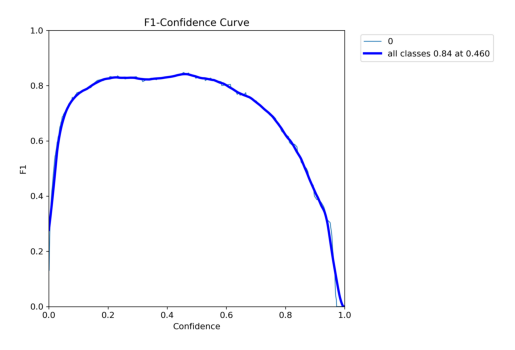

In [47]:
plot('/content/yolov8/runs/detect/val/F1_curve.png')

### PR curve

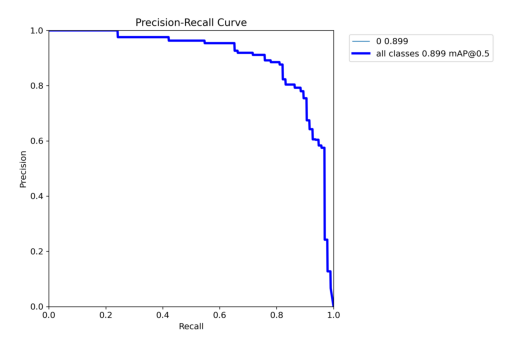

In [49]:
plot('/content/yolov8/runs/detect/val/PR_curve.png')

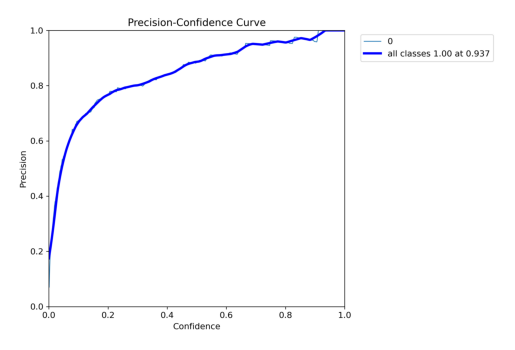

In [50]:
plot('/content/yolov8/runs/detect/val/P_curve.png')

### Confusion Matrix

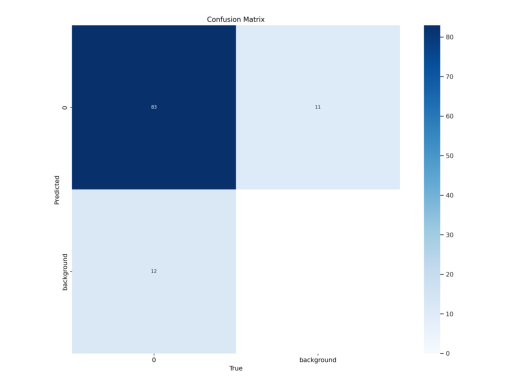

In [51]:
plot('/content/yolov8/runs/detect/val/confusion_matrix.png')

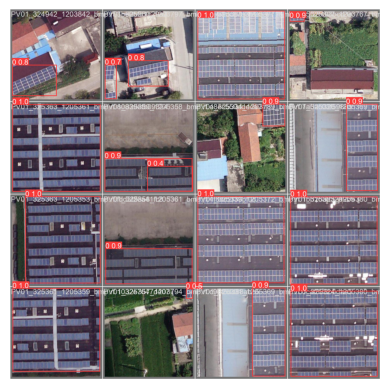

In [52]:
plot("/content/yolov8/runs/detect/val/val_batch0_pred.jpg")

###**Predictions**


This is used to make predictions using the trained YOLOv8 object detection model on new, unseen images.

Here's a breakdown of the command:

**`conf=CONF`**: Sets the confidence threshold for object detection. The CONF variable contains the specified confidence value.

**`source={Object_Detection_Dataset.location}/test/images`**: Specifies the path to the folder containing the test images. It uses the location of the downloaded object detection dataset and the test/images directory.

In [ ]:
!yolo task=detect mode=predict model={ROOT_DIR}/runs/detect/train/weights/best.pt conf=0.25 source={Object_Detection_Dataset.location}/test/images

Ultralytics YOLOv8.0.105 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients

image 1/42 /content/yolov8/pannelli-1/test/images/PV01_325127_1204235_bmp.rf.b155142053bf2035e6471dcf4b03c80b.jpg: 640x640 1 0, 17.2ms
image 2/42 /content/yolov8/pannelli-1/test/images/PV01_325127_1204237_bmp.rf.38733bb335ceb1fbdb5104567c2bbafd.jpg: 640x640 3 0s, 16.3ms
image 3/42 /content/yolov8/pannelli-1/test/images/PV01_325127_1204254_bmp.rf.cbc926c193f08a8c0b59c2cddb19c602.jpg: 640x640 1 0, 16.3ms
image 4/42 /content/yolov8/pannelli-1/test/images/PV01_325130_1204227_bmp.rf.84329742271d16aa6081a775e460b1ac.jpg: 640x640 1 0, 16.3ms
image 5/42 /content/yolov8/pannelli-1/test/images/PV01_325139_1204237_bmp.rf.24740778ff09574b58ab841c606668f0.jpg: 640x640 (no detections), 16.2ms
image 6/42 /content/yolov8/pannelli-1/test/images/PV01_325159_1203815_bmp.rf.43afc6aa7f808b85aa3a044b18dc025e.jpg: 640x640 1 0, 16.3ms
image 7/42 /content/

## **Show Model Prediction**

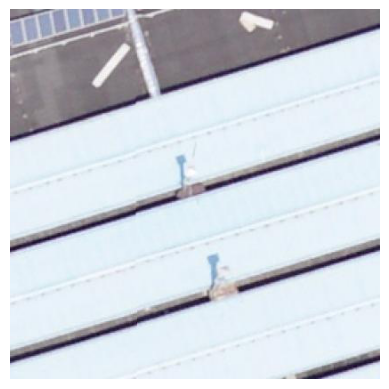

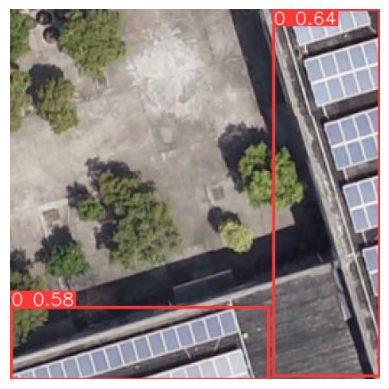

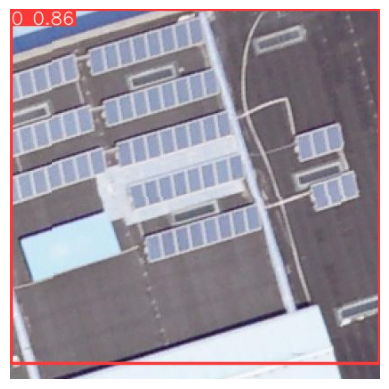

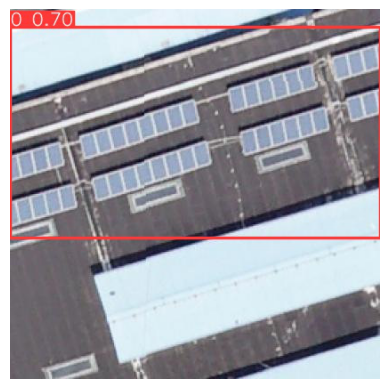

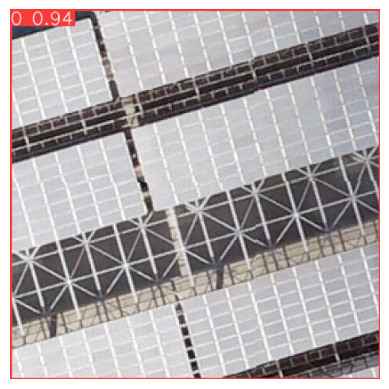

...

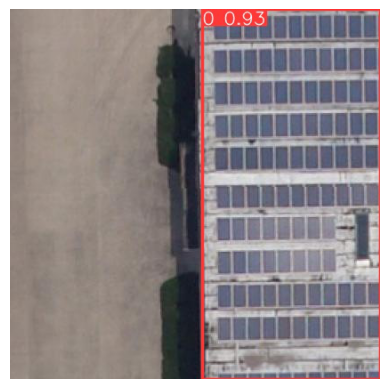

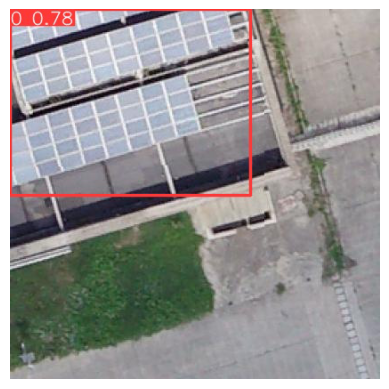

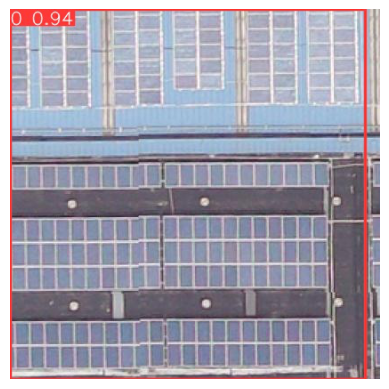

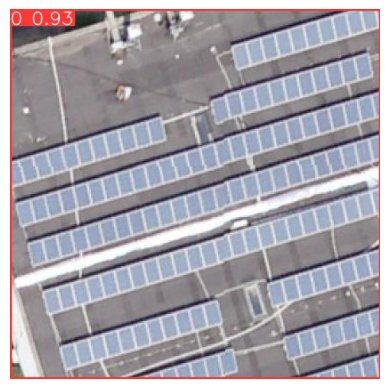

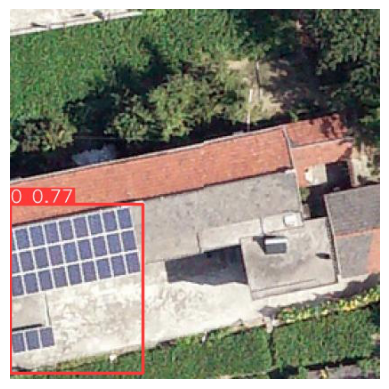

In [56]:
import glob

# Specify the folder path containing the .jpg files
folder_path = '/content/yolov8/runs/detect/predict/'

# Get a list of file paths for all .jpg files in the folder
file_paths = glob.glob(folder_path + '*.jpg')

# Iterate over the file paths and plot each image
for file_path in file_paths:
    plot(file_path)


## **Segmentation**

### download dataset

In [ ]:
project = rf.workspace("solarpanel-3ku0x").project("solar_panel-cvecl")
Instance_Segmentation_Dataset = project.version(3).download("yolov8")

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.105, to fix: `pip install ultralytics<=8.0.20`


Extracting Dataset Version Zip to Solar_Panel-3 in yolov8:: 100%|██████████| 15670/15670 [00:03<00:00, 4066.69it/s]


In [ ]:
{Instance_Segmentation_Dataset}

{<roboflow.core.dataset.Dataset at 0x7ff8ac0dc970>}

---


This code is used to train the YOLOv8 model for solar panel segmentation.

**`task=segment`**: Specifies the task as instance segmentation.

**`model='yolov8n-seg.pt'`**: Specifies the model architecture to be used for training (in this case, 'yolov8n-seg.pt').

##**Fine-Tuning Instance Segmentation Model**

###**Training**

In [ ]:
!yolo task=segment mode=train model='yolov8n-seg.pt' data={Instance_Segmentation_Dataset.location}/data.yaml epochs=20 imgsz=640

Ultralytics YOLOv8.0.105 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=segment, mode=train, model=yolov8n-seg.pt, data=/content/yolov8/Solar_Panel-3/data.yaml, epochs=20, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False, int8=False, dynamic=False, sim

###**Evaluate**

In [ ]:
!yolo task=segment mode=val model={ROOT_DIR}/runs/segment/train/weights/best.pt data={Instance_Segmentation_Dataset.location}/data.yaml

Ultralytics YOLOv8.0.105 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n-seg summary (fused): 195 layers, 3258259 parameters, 0 gradients
val: Scanning /content/yolov8/Solar_Panel-3/valid/labels.cache... 1374 images, 57 backgrounds, 0 corrupt: 100% 1374/1374 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% 86/86 [00:30<00:00,  2.80it/s]
                   all       1374       6247      0.842      0.732       0.79      0.606      0.859      0.711      0.777       0.54
Speed: 0.6ms preprocess, 5.0ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/segment/val


## **Plot Instance Segmentation Training Results**

#### **BoxF1_curve**

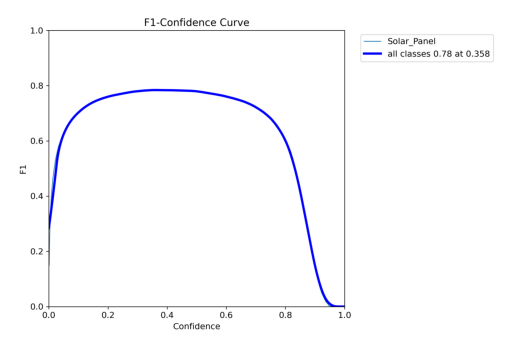

In [57]:
plot('/content/yolov8/runs/segment/val/BoxF1_curve.png')

### **BoxPR_curve**

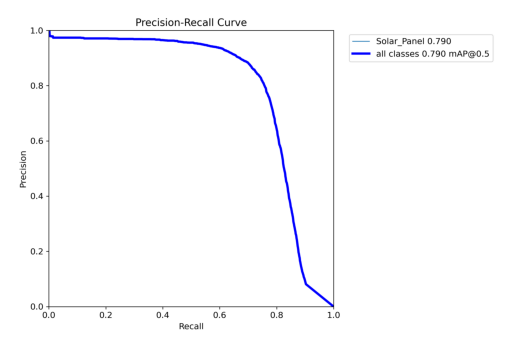

In [58]:
plot('/content/yolov8/runs/segment/val/BoxPR_curve.png')

#### **BoxP_curve**

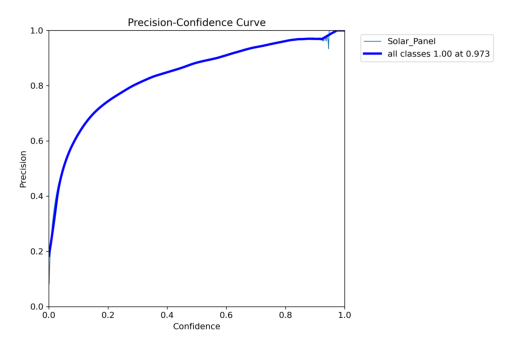

In [62]:
plot('/content/yolov8/runs/segment/val/BoxP_curve.png')

#### **BoxR_curve**

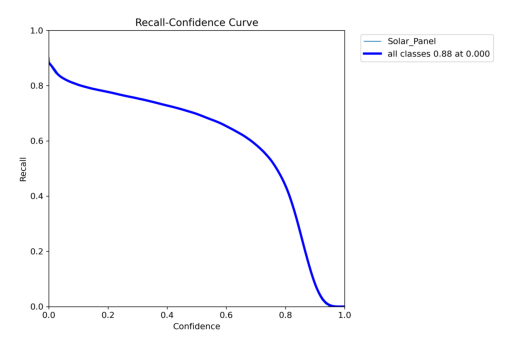

In [61]:
plot('/content/yolov8/runs/segment/val/BoxR_curve.png')

#### **MaskF1_curve**

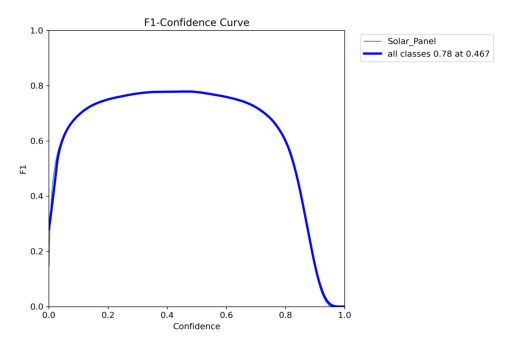

In [60]:
plot('/content/yolov8/runs/segment/val/MaskF1_curve.png')

#### **MaskPR_curve**

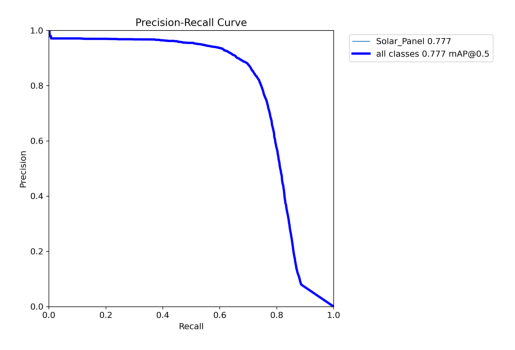

In [59]:
plot('/content/yolov8/runs/segment/val/MaskPR_curve.png')

#### **MaskP_curve**

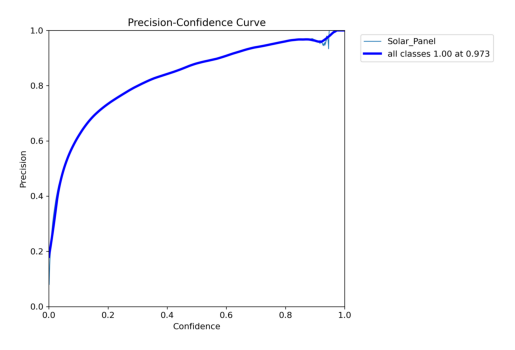

In [63]:
plot('/content/yolov8/runs/segment/val/MaskP_curve.png')

#### **MaskR_curve**

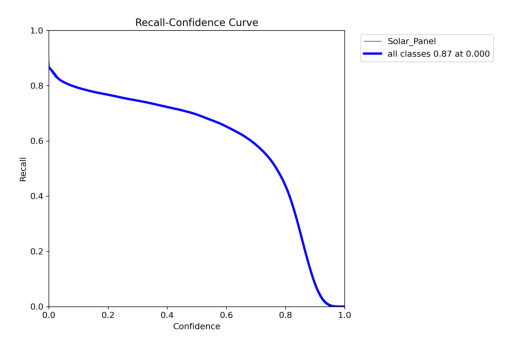

In [65]:
plot('/content/yolov8/runs/segment/val/MaskR_curve.png')

#### Confusion Matrix

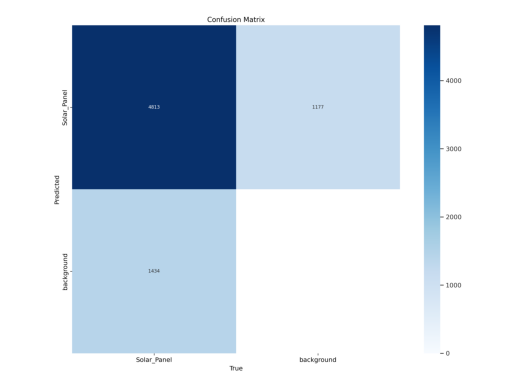

In [66]:
plot('/content/yolov8/runs/segment/val/confusion_matrix.png')

###**Predictions**

In [ ]:
!yolo task=segment mode=predict model={ROOT_DIR}/runs/segment/train/weights/best.pt conf=0.25 source={Instance_Segmentation_Dataset.location}/test/images

Ultralytics YOLOv8.0.105 🚀 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n-seg summary (fused): 195 layers, 3258259 parameters, 0 gradients

image 1/610 /content/yolov8/Solar_Panel-3/test/images/1048-S-River-Meadows-Dr_Fayetteville_AR-72701_United-States_t58519_jpg.rf.84f52621bbcd3967b663c6f7106d8340.jpg: 640x640 2 Solar_Panels, 24.9ms
image 2/610 /content/yolov8/Solar_Panel-3/test/images/1209-S-Gentle-Valley-Dr_Fayetteville_AR-72704_United-States_t2656_jpg.rf.c3cb2c5b59325fc130b503e4de7bed5e.jpg: 640x640 4 Solar_Panels, 9.8ms
image 3/610 /content/yolov8/Solar_Panel-3/test/images/2183-E-Wolf-Creek-Dr_Huntingdon_AR-72703_United-States_t43697_jpg.rf.74e7441210c7ea649045de559831e152.jpg: 640x640 4 Solar_Panels, 9.5ms
image 4/610 /content/yolov8/Solar_Panel-3/test/images/3090-Birch-Pl_Springdale_AR-72762_United-States_t72090_jpg.rf.a3a31da00c69c255dbcadff3ddd9d827.jpg: 640x640 1 Solar_Panel, 9.7ms
image 5/610 /content/yolov8/Solar_Panel-3/test/images/409-Lion-Dr-N_Waln

## Show Model Prediction

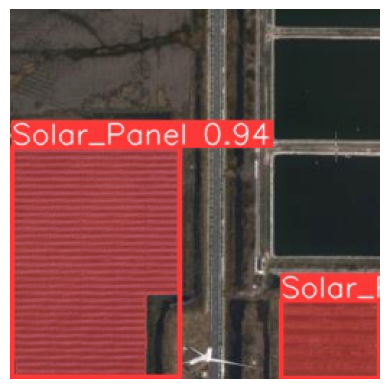

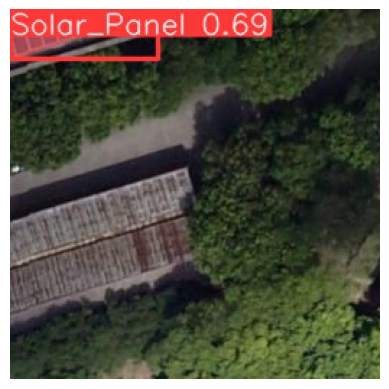

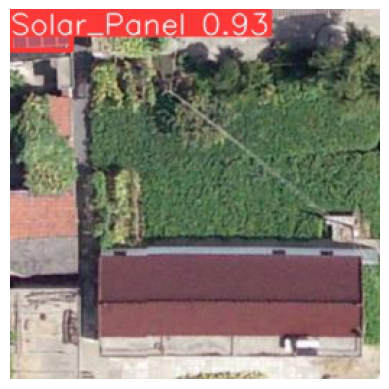

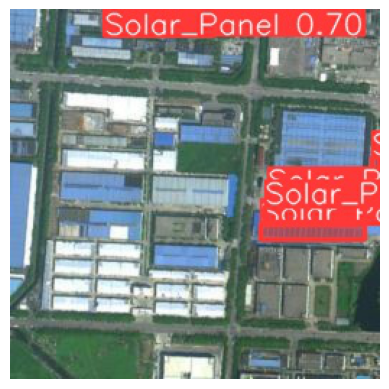

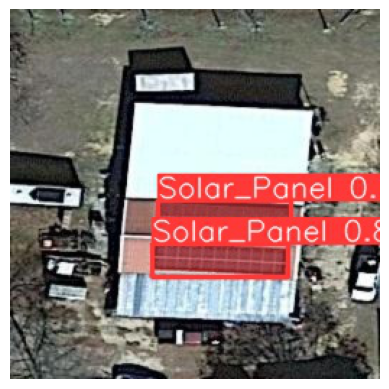

...

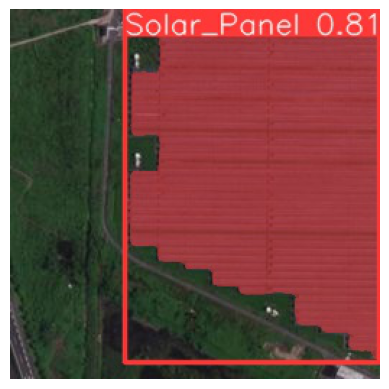

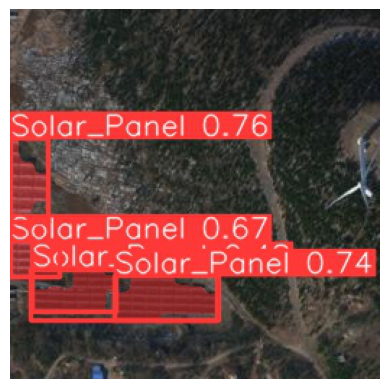

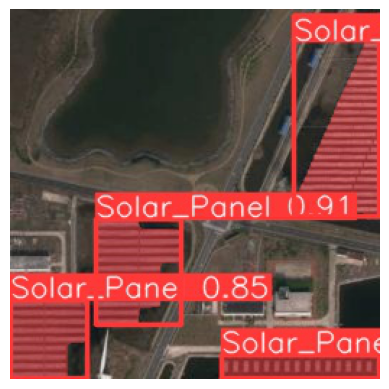

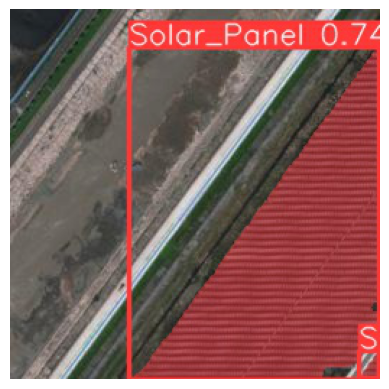

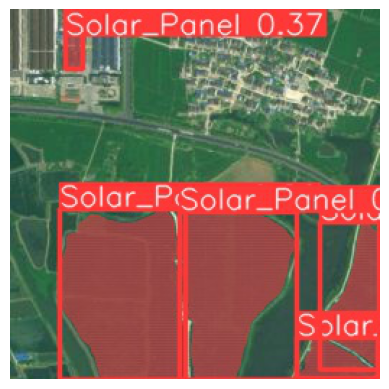

In [ ]:
import glob

# Specify the folder path containing the .jpg files
folder_path = '/content/yolov8/runs/segment/predict/'

# Get a list of file paths for all .jpg files in the folder
file_paths = glob.glob(folder_path + '*.jpg')

# Iterate over the file paths and plot each image
for file_path in file_paths:
    plot(file_path)

## **Training Curves in Tensorboard**

In [69]:
%load_ext tensorboard

In [70]:
%tensorboard --logdir {ROOT_DIR}/runs/detect/train

<IPython.core.display.Javascript object>